In [51]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [2]:
df_test = pd.read_csv("test-full.csv")
df_train = pd.read_csv("train.csv")
# pour avoir cover type au début
df_train = df_train[[df_train.columns[-1]] + list(df_train.columns[0:-1])]

In [3]:
df_train.shape, df_test.shape

((15120, 56), (581012, 55))

In [4]:
df_test.head()

,Id,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,...,Soil_Type31,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40
0,1,2596,51,3,258,0,510,221,232,148,...,0,0,0,0,0,0,0,0,0,0
1,2,2590,56,2,212,-6,390,220,235,151,...,0,0,0,0,0,0,0,0,0,0
2,3,2804,139,9,268,65,3180,234,238,135,...,0,0,0,0,0,0,0,0,0,0
3,4,2785,155,18,242,118,3090,238,238,122,...,0,0,0,0,0,0,0,0,0,0
4,5,2595,45,2,153,-1,391,220,234,150,...,0,0,0,0,0,0,0,0,0,0


In [5]:
df_train["Cover_Type"].value_counts()

1    2160
2    2160
3    2160
4    2160
5    2160
6    2160
7    2160
Name: Cover_Type, dtype: int64

### Basis script

In [9]:
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt

# Separate features and target 
X_train = df_train.drop('Cover_Type', axis=1)
y_train = df_train['Cover_Type']

# Initialize and train a Random Forest classifier
clf = RandomForestClassifier(n_estimators=100, random_state=42)
clf.fit(X_train, y_train)

# Creating a Test dataset
X_test = df_test

# Make predictions on the test dataset
y_pred = clf.predict(X_test)

# Saving predictions to a CSV file
predictions_df = pd.DataFrame({'Cover_Type': y_pred})

# Having it fit the desired format
Id = [i for i in range (1, 581013)]
predictions_df['Id'] = Id
predictions_df.to_csv('test_predictions.csv', index=False) # peut-être plus simple de directement mettre index = True


In [10]:
predictions_df["Cover_Type"].value_counts()

2    236112
1    216326
3     38178
7     31667
5     28425
6     26278
4      4026
Name: Cover_Type, dtype: int64

### First train-test

In [11]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report

def RF_classif(df_train=df_train):
    # Separate features and target 
    X_train = df_train.drop('Cover_Type', axis=1)
    y_train = df_train['Cover_Type']

    data_train, data_test, target_train, target_test = train_test_split(
        X_train, y_train, test_size = 0.2
    )

    # Initialize and train a Random Forest classifier
    clf = RandomForestClassifier(n_estimators=100, random_state=42)
    clf.fit(data_train, target_train)

    # Make predictions on the test dataset
    y_pred = clf.predict(data_test)
    
    return target_test, y_pred

In [12]:
y_true, y_pred = RF_classif()
accuracy_score(y_true, y_pred) # bien meilleur score que sur Kags

0.8763227513227513

In [13]:
pd.DataFrame(sorted(np.stack([clf.feature_names_in_, clf.feature_importances_* 100]).T, key=lambda x: x[1], reverse=True))

,0,1
0,Elevation,20.632355
1,Id,13.322041
2,Horizontal_Distance_To_Roadways,8.330502
3,Horizontal_Distance_To_Fire_Points,6.130473
4,Horizontal_Distance_To_Hydrology,4.918169
5,Wilderness_Area4,4.871603
6,Vertical_Distance_To_Hydrology,4.423837
7,Hillshade_9am,4.357751
8,Aspect,4.033937
9,Hillshade_3pm,3.803219


In [14]:
print(classification_report(y_true, y_pred))

# On prédit moins bien 1 et 2, ce qui est un problème pcq représentent une immense majorité du dataset final

              precision    recall  f1-score   support

           1       0.83      0.78      0.80       472
           2       0.79      0.70      0.74       430
           3       0.85      0.86      0.85       407
           4       0.95      0.98      0.96       396
           5       0.89      0.96      0.93       445
           6       0.90      0.88      0.89       457
           7       0.93      0.99      0.96       417

    accuracy                           0.88      3024
   macro avg       0.87      0.88      0.88      3024
weighted avg       0.87      0.88      0.87      3024



In [15]:
a = pd.DataFrame(pd.DataFrame(y_true).value_counts(), columns=["True"])
b = pd.DataFrame(pd.DataFrame(y_pred).value_counts(), columns=["Pred"])

a.loc[range(1,8)], b.loc[range(1,8)]

(            True
 Cover_Type      
 1            472
 2            430
 3            407
 4            396
 5            445
 6            457
 7            417,
    Pred
 0      
 1   446
 2   382
 3   415
 4   409
 5   482
 6   446
 7   444)

# Looking into the data

In [16]:
sns.heatmap(df_train.iloc[:,:16].corr(), cmap = 'vlag') ## sans les soils sinon illisble

<Axes: >

### Wilderness Areas

In [17]:
wilderness_types = ["Wilderness_Area1", "Wilderness_Area2", "Wilderness_Area3", "Wilderness_Area4"]
(df_train[wilderness_types].sum() / len(df_train))

Wilderness_Area1    0.235979
Wilderness_Area2    0.037632
Wilderness_Area3    0.416799
Wilderness_Area4    0.309590
dtype: float64

In [18]:
(df_test[wilderness_types].sum() / len(df_test))

Wilderness_Area1    0.448865
Wilderness_Area2    0.051434
Wilderness_Area3    0.436074
Wilderness_Area4    0.063627
dtype: float64

On voit que le WA4 est très surreprésenté dans le train vs le test. Inversement, le WA1 est sous-représenté
=> essayer dans un second temps de regarder WA par WA les erreurs

#### Lien zone WA

In [19]:
df_train["Wilderness_Area_Synth"] = df_train[wilderness_types] @ [1, 2, 3, 4]

In [20]:
df_train[["Wilderness_Area_Synth"]].value_counts(normalize=True)

Wilderness_Area_Synth
3                        0.416799
4                        0.309590
1                        0.235979
2                        0.037632
dtype: float64

In [21]:
WA_CT = pd.DataFrame(index=range(1, 5), columns=range(1, 8))
for WA in range(1,5):
    for CT in range(1, 8):
        WA_CT.loc[WA, CT] = len(df_train[(df_train["Wilderness_Area_Synth"] == WA) & (df_train["Cover_Type"] == CT)])

In [22]:
WA_CT.T

,1,2,3,4
1,1068,237,855,0
2,1105,85,949,21
3,0,0,856,1304
4,0,0,0,2160
5,862,0,1298,0
6,0,0,964,1196
7,533,247,1380,0


### Soil Types

In [23]:
soil_types = ["Soil_Type" + str(i) for i in range(1, 41)]
soils_train = pd.DataFrame(df_train[soil_types].sum() / len(df_train) * 100, columns=["Train"])
soils_test = pd.DataFrame(df_test[soil_types].sum() / len(df_test) * 100, columns=["Test"])

In [24]:
sns.heatmap(pd.merge(soils_train, soils_test, left_index=True, right_index=True))
# Ca ne colle pas 

<Axes: >

Certains sont à 5 => binner tous ceux en dessous de 200 ou qqc comme ça

In [25]:
# Y en a-t-il des vraiment corrélés avec Cover type ? Pas beaucoup
sns.heatmap(abs(df_train[["Cover_Type"] + soil_types].corr()) > 0.15)

<Axes: >

In [26]:
# Et avec les autres ? Pas énormes non plus à part ceux déjà repérés
sns.heatmap(abs(df_train.corr()) > 0.2)

<Axes: >

#### Si on essaie sans les soil types

In [27]:
df_train_nosoil = df_train.iloc[:,:16]
y_true, y_pred = RF_classif(df_train_nosoil)

print(classification_report(y_true, y_pred))

              precision    recall  f1-score   support

           1       0.79      0.81      0.80       438
           2       0.83      0.68      0.75       448
           3       0.88      0.86      0.87       436
           4       0.93      0.98      0.96       428
           5       0.89      0.96      0.93       445
           6       0.85      0.86      0.85       416
           7       0.93      0.98      0.96       413

    accuracy                           0.87      3024
   macro avg       0.87      0.88      0.87      3024
weighted avg       0.87      0.87      0.87      3024



Ne change rien => faire sans pour l'instant, on verra ensuite comment biner

# Sans les soil types

In [28]:
sns.heatmap((abs(df_train_nosoil.corr()) > 0.2) * df_train_nosoil.corr(), cmap='vlag') ## sans les soils sinon illisble

<Axes: >

### Une TSNE

In [29]:
from sklearn.manifold import TSNE

X_train_ns = df_train_nosoil.drop('Cover_Type', axis=1)
y_train_ns = df_train_nosoil['Cover_Type']

In [30]:
tsne = TSNE(verbose=True, n_components=2)
tsne_repr = tsne.fit_transform(X_train_ns)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 15120 samples in 0.032s...
[t-SNE] Computed neighbors for 15120 samples in 0.349s...
[t-SNE] Computed conditional probabilities for sample 1000 / 15120
[t-SNE] Computed conditional probabilities for sample 2000 / 15120
[t-SNE] Computed conditional probabilities for sample 3000 / 15120
[t-SNE] Computed conditional probabilities for sample 4000 / 15120
[t-SNE] Computed conditional probabilities for sample 5000 / 15120
[t-SNE] Computed conditional probabilities for sample 6000 / 15120
[t-SNE] Computed conditional probabilities for sample 7000 / 15120
[t-SNE] Computed conditional probabilities for sample 8000 / 15120
[t-SNE] Computed conditional probabilities for sample 9000 / 15120
[t-SNE] Computed conditional probabilities for sample 10000 / 15120
[t-SNE] Computed conditional probabilities for sample 11000 / 15120
[t-SNE] Computed conditional probabilities for sample 12000 / 15120
[t-SNE] Computed conditional probabilities for sam

Exception in thread Thread-30 (_readerthread):
Traceback (most recent call last):
  File "c:\Users\User\anaconda3\Lib\threading.py", line 1038, in _bootstrap_inner
    self.run()
  File "c:\Users\User\anaconda3\Lib\threading.py", line 975, in run
    self._target(*self._args, **self._kwargs)
  File "c:\Users\User\anaconda3\Lib\subprocess.py", line 1597, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xa0 in position 16: invalid start byte
c:\Users\User\anaconda3\Lib\site-packages\joblib\externals\loky\backend\context.py:110: UserWarning: Could not find the number of physical cores for the following reason:
found 0 physical cores < 1
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "c:\Users\User\anaconda3\Lib\site-packages\joblib\externals\loky

[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.071495
[t-SNE] KL divergence after 1000 iterations: 0.644748


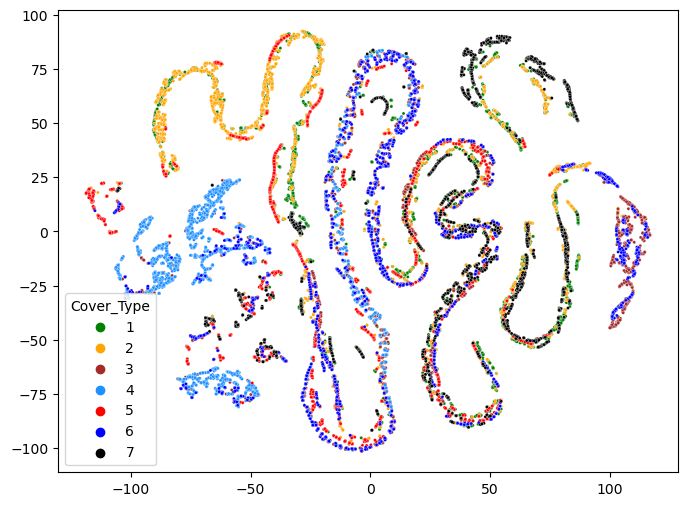

In [69]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x=tsne_repr[:, 0], y=tsne_repr[:, 1], hue=y_train_ns,
                palette=['green','orange','brown','dodgerblue','red', 'blue', 'black'],
                s=5)
plt.show()

In [32]:
df_test_ns = df_test.iloc[:,:15]

### Une PCA

In [33]:
from sklearn.decomposition import PCA 

pca = PCA(n_components=2)
X_2D = pca.fit_transform(X_train_ns)

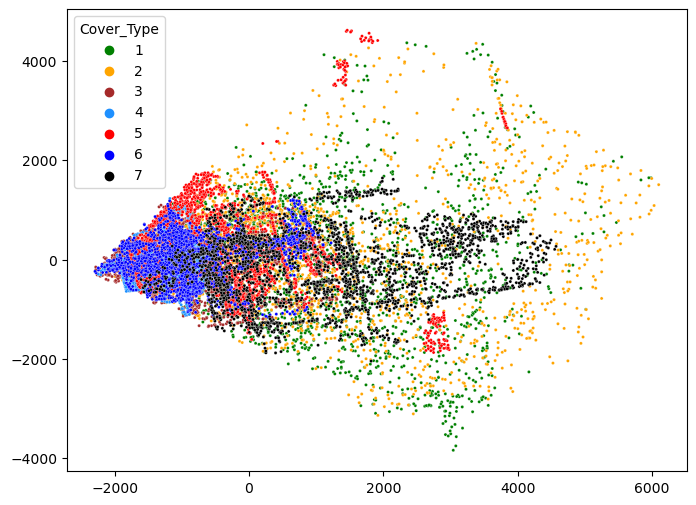

In [70]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x=X_2D[:, 0], y=X_2D[:, 1], hue=y_train_ns,
                palette=['green','orange','brown','dodgerblue','red', 'blue', 'black'],
                s=5)
plt.show()
# On voit que les 1 et 2 sont beaucoup plus dispersés que les autres ici, ce qui peut expliquer la difficulté à les prédire

In [35]:
pca.explained_variance_ratio_

array([9.99899594e-01, 7.27579503e-05])

On voit que la projection sur une dimension explique 99.99% de la variance (??)

In [36]:
pca2 = PCA(n_components=1)
X_test_10D = pca.fit_transform(df_test)
pca.explained_variance_ratio_
# Pareil pour df_test !

array([9.99867467e-01, 8.17774791e-05])

In [37]:
pca = PCA(n_components=1)
X_1D = pca.fit_transform(X_train_ns)
df_reduced = pd.DataFrame(np.stack([y_train_ns, X_1D.ravel()]).T, columns=["Cover_Type", "1D"])

In [38]:
y_true, y_pred = RF_classif(df_reduced)
accuracy_score(y_true, y_pred)

0.6716269841269841

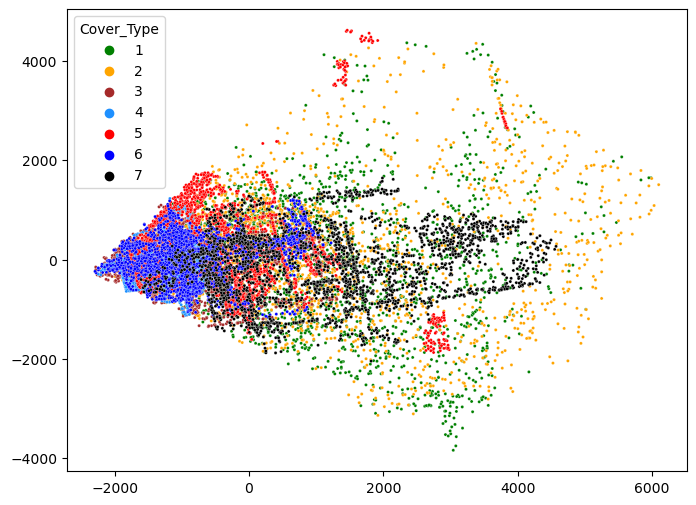

In [71]:
### Sans ID

from sklearn.decomposition import PCA 

pca = PCA(n_components=2)
X_2D = pca.fit_transform(X_train_ns.drop(columns='Id'))
plt.figure(figsize=(8, 6))
sns.scatterplot(x=X_2D[:, 0], y=X_2D[:, 1], hue=y_train_ns,
                palette=['green','orange','brown','dodgerblue','red', 'blue', 'black'],
                s=5)
plt.show()
# On voit que les 1 et 2 sont beaucoup plus dispersés que les autres ici, ce qui peut expliquer la difficulté à les prédire

In [40]:
pca.explained_variance_ratio_.sum() # Plus réaliste et déjà pas mal

0.9484606688511428

In [41]:
df_reduced = pd.DataFrame(np.c_[y_train_ns, X_2D], columns=["Cover_Type", "1D", "2D"])
y_true, y_pred = RF_classif(df_reduced)
accuracy_score(y_true, y_pred)

0.4487433862433862

bizarre parce que semble largement déterminé par la scale des features (expliqué à 99% pcq échelle des indices de loin supérieure mais ne change rien uand on scale - heureusement pcq pca censée déjà scaler)

### Si on essaie d'oversampler Cover_Type = 2

In [42]:
from imblearn.over_sampling import ADASYN
n_neighbors = 9

# EACH VARIABLE IN DETAIL

In [6]:
import ydata_profiling
df_test.profile_report() 

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
df_train.profile_report() 

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

- ID

In [45]:
a = 0
for i in df_train["Id"]:
    if i in df_test["Id"]:
        a += 1
print(a)

# les données du train sont contenues dans le full dataset !

15120


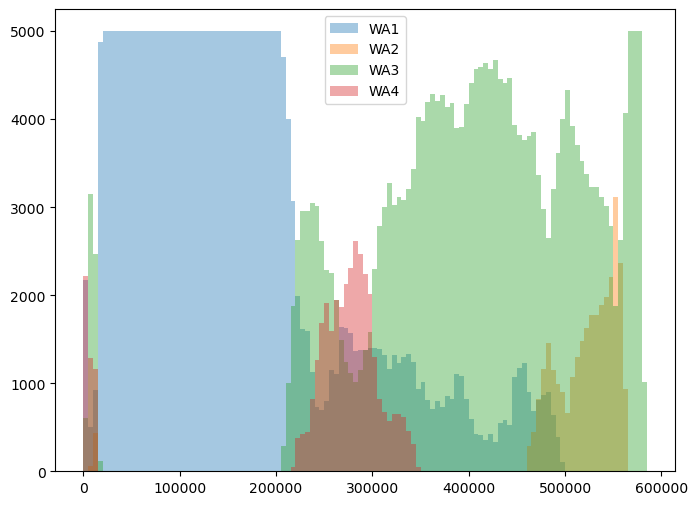

In [80]:
# Répartition des Ids par WA?

binwidth = 5_000

plt.figure(figsize=(8,6))
for i in range (1, 5):
    plt.hist(df_test[df_test[f"Wilderness_Area{i}"] == 1]["Id"], 
             bins=range(1, max(df_test['Id']) + binwidth, binwidth), label=f"WA{i}", alpha=0.4)
    plt.legend()
    
# peut être nice de représenter ça avec des stacked bars pour voir la proportion sur chaque bin
# https://matplotlib.org/stable/gallery/lines_bars_and_markers/bar_stacked.html

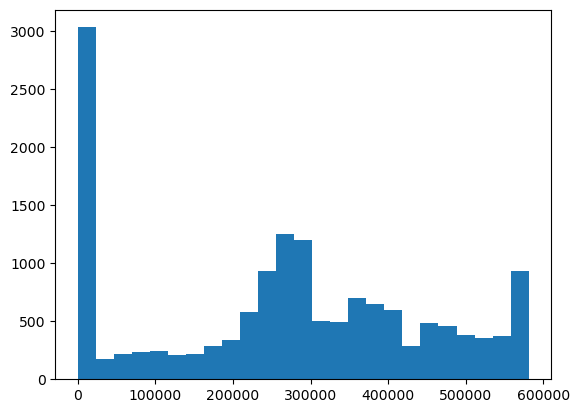

In [65]:
plt.hist(df_train["Id"], bins='auto')
plt.show()
# on voit que on a démesurément pris des Id dans des endroits où le WA est 3 (tout début et milieu)

- Elevation

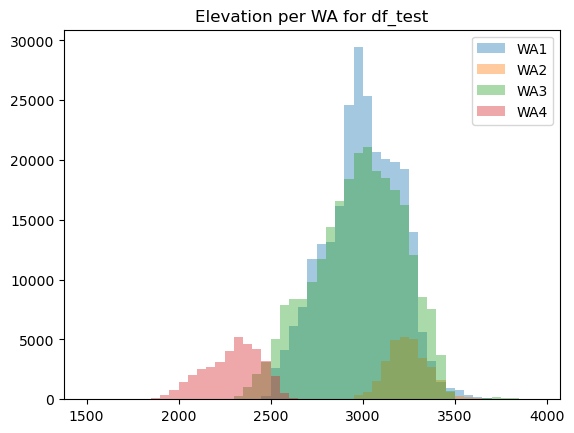

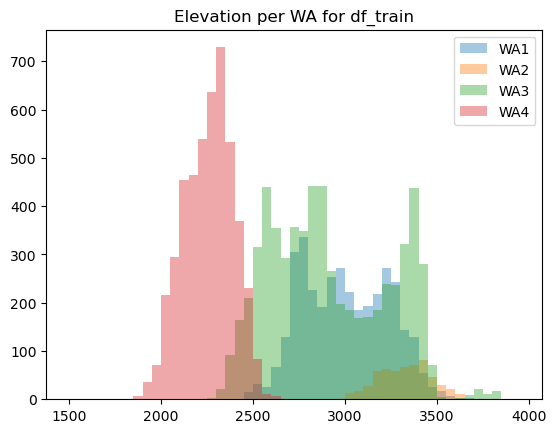

In [94]:
dico = {"df_test": df_test, "df_train": df_train}

for df in dico:
    for i in range(1, 5):
        plt.hist(dico[df][dico[df][f"Wilderness_Area{i}"] == 1]["Elevation"], 
                label=f"WA{i}", alpha=0.4, bins=range(1500, 4000, 50))
    plt.title(f"Elevation per WA for {df}")
    plt.legend()
    plt.show()

In [95]:
### Au delà de la surreprésentation de W4, intéressant de voir que même au sein de WA1 et WA2 on n'a pas samplé uniformément 
# : il manque le pic autour de 3000

- Aspect

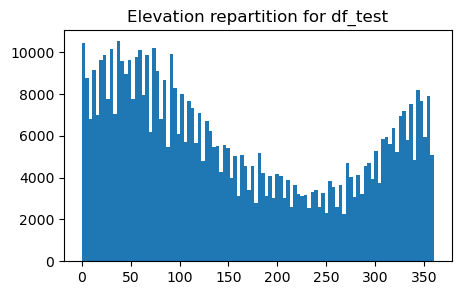

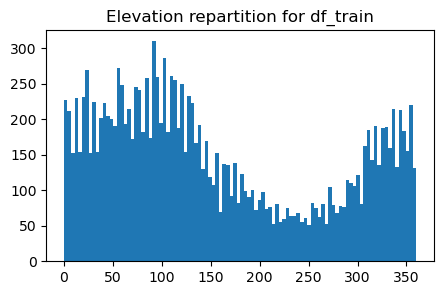

In [104]:
# C'est l'azimuth de la pente, ie en gros l'angle du gradient de la montagne (0° pour pente nord etc)

for df in dico:
    plt.figure(figsize=(5, 3))
    plt.hist(dico[df]["Aspect"], bins=100)
    plt.title(f"Elevation repartition for {df}")
    plt.show()
    
# Ici ok

- Slope

In [111]:
for i, df in enumerate(dico):
    print(i, df)

0 df_test
1 df_train


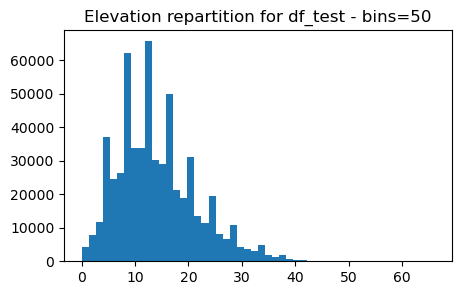

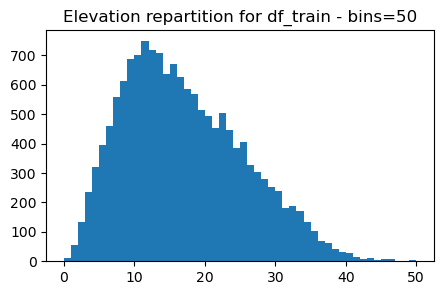

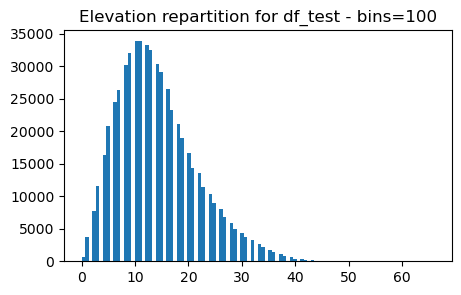

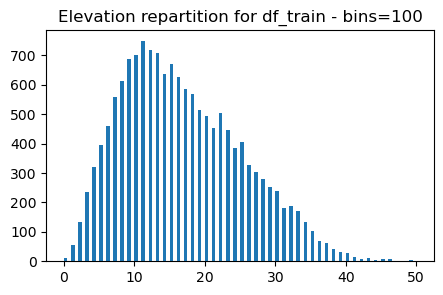

In [117]:

for bin in [50, 100]:
    for df in dico:
        plt.figure(figsize=(5,3))
        plt.hist(dico[df]["Slope"], bins=bin)
        plt.title(f"Elevation repartition for {df} - bins={bin}")
        plt.show()


In [ ]:
# pas samplé uniformément